### Imports

In [1]:
import os
import json
import base64
from io import BytesIO
from PIL import Image
import torch
from transformers import CLIPProcessor, CLIPModel
from opensearchpy import OpenSearch
import matplotlib.pyplot as plt
from IPython.display import display
import numpy as np

The installed version of bitsandbytes was compiled without GPU support. 8-bit optimizers, 8-bit multiplication, and GPU quantization are unavailable.


In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"

host = 'api.novasearch.org'
port = 443
user = 'user04'
password = 'no.LIMITS2100'
index_name = user

client = OpenSearch(
    hosts=[{'host': host, 'port': port}],
    http_compress=True,
    http_auth=(user, password),
    use_ssl=True,
    url_prefix='opensearch_v2',
    verify_certs=False,
    ssl_assert_hostname=False,
    ssl_show_warn=False
)

clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32").to(device)
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

c:\Users\tneto\anaconda3\envs\nlp-cv-ir\lib\site-packages\huggingface_hub\file_download.py:797: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
c:\Users\tneto\anaconda3\envs\nlp-cv-ir\lib\site-packages\torch\_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


In [3]:
# Load Video Frames
def compute_clip_embeddings(frame_folder):
    embeddings = {}
    for filename in sorted(os.listdir(frame_folder)):
        if not filename.endswith(".jpg"):
            continue
        image_path = os.path.join(frame_folder, filename)
        image = Image.open(image_path).convert("RGB")
        inputs = clip_processor(images=image, return_tensors="pt").to(device)
        with torch.no_grad():
            outputs = clip_model.get_image_features(**inputs)
            embedding = outputs[0] / outputs[0].norm(p=2)
            embeddings[filename] = embedding.tolist()
    print(f"Computed CLIP embeddings for {len(embeddings)} frames in {frame_folder}")
    return embeddings

In [4]:
def encode_frame_to_vector(image_path):
    image = Image.open(image_path).convert("RGB")
    inputs = clip_processor(images=image, return_tensors="pt").to(device)
    with torch.no_grad():
        outputs = clip_model.get_image_features(**inputs)
        embedding = outputs[0] / outputs[0].norm(p=2)
        return embedding.tolist()

In [5]:
# Search for Similar Frames using CLIP embedding
def search_similar_frames(query_vector, k=5):
    query_knn = {
        "size": k,
        "_source": ["video_id", "image_path"],
        "query": {
            "knn": {
                "image_vec": {
                    "vector": query_vector,
                    "k": k
                }
            }
        }
    }
    response = client.search(index=index_name, body=query_knn)
    return response["hits"]["hits"]

In [6]:
# Display Similar Frames
def display_similar_frames(query_frame_path, k=5):
    print(f"🔎 Query: {query_frame_path}")
    query_vec = encode_frame_to_vector(query_frame_path)
    results = search_similar_frames(query_vec, k=k)

    display(Image.open(query_frame_path))
    print("Similar Frames:")
    for hit in results:
        img_path = hit["_source"]["image_path"].replace("\\", "/")
        print(f"- {img_path}")
        display(Image.open(img_path))

In [ ]:
# Interactive navigation
def navigation_by_similarity(start_frame_path, depth=3, k=3):
    visited = set()
    current_frame = start_frame_path
    for step in range(depth):
        print(f"Step {step+1}/{depth}")
        display_similar_frames(current_frame, k=k)
        visited.add(current_frame)

        next_frame = input("➡ Write image path to search similarity or click ENTER to close the search bar: ").strip()
        if not next_frame or next_frame in visited:
            print("Closed.")
            break
        current_frame = next_frame

Step 1/3
🔎 Query: data/frames/v_-rKS00dzFxQ/frame_0050.jpg


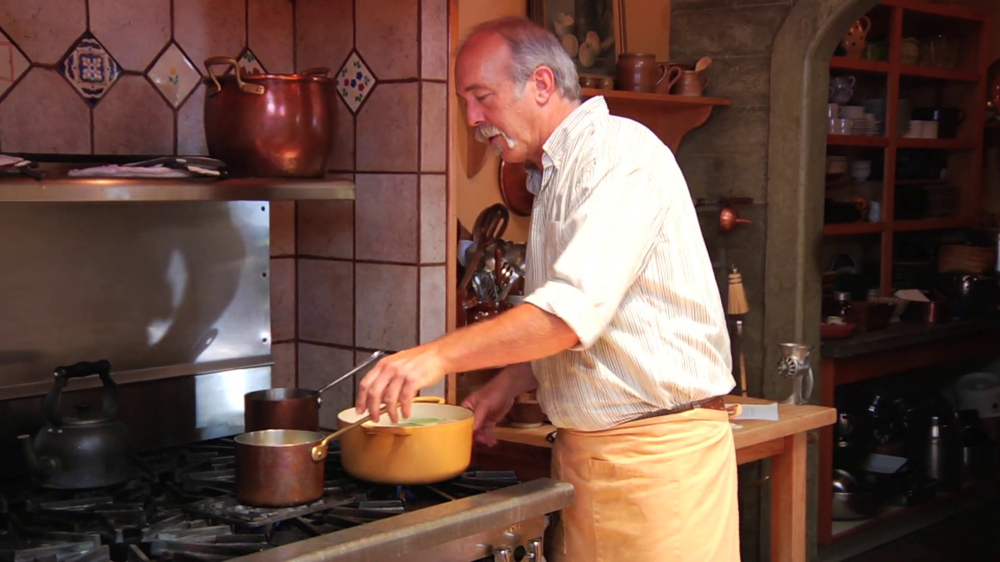

Similar Frames:
- data/frames/v_-rKS00dzFxQ/frame_0050.jpg


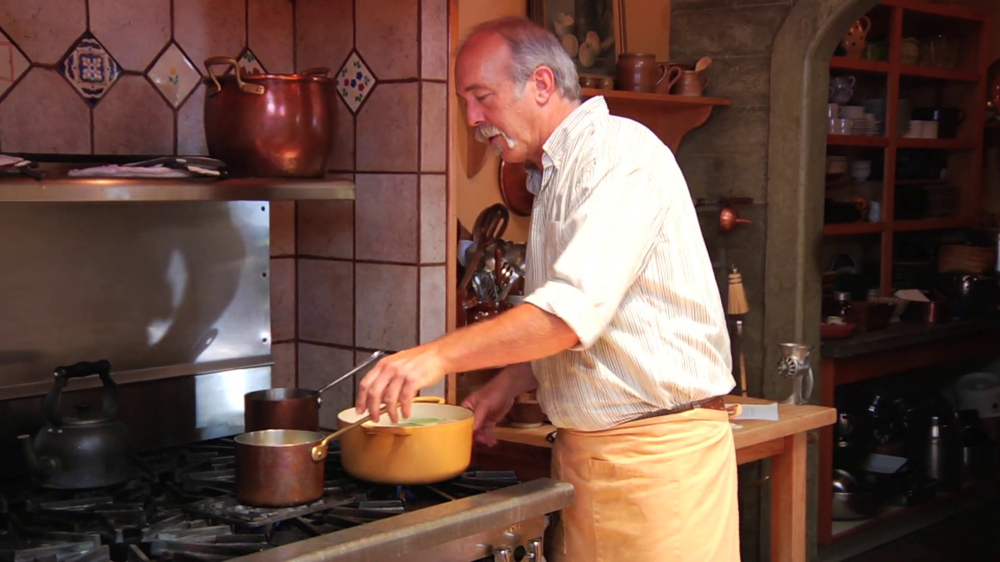

- data/frames/v_-rKS00dzFxQ/frame_0052.jpg


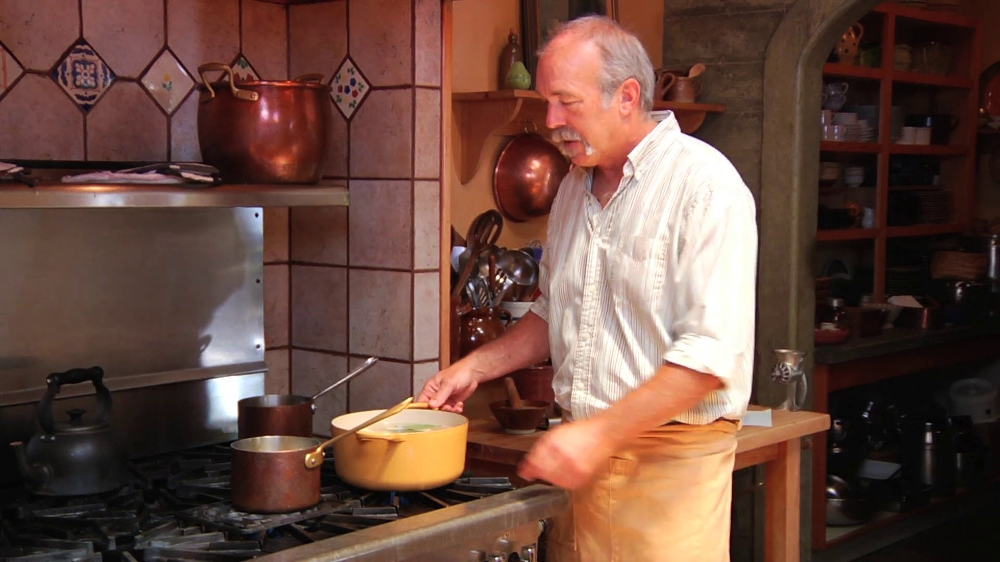

- data/frames/v_-rKS00dzFxQ/frame_0053.jpg


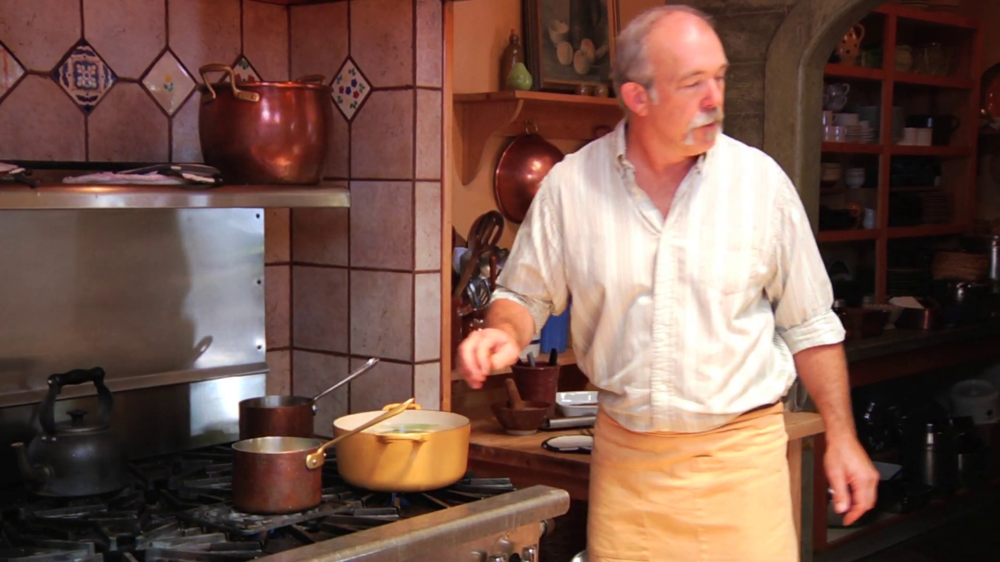

- data/frames/v_-rKS00dzFxQ/frame_0051.jpg


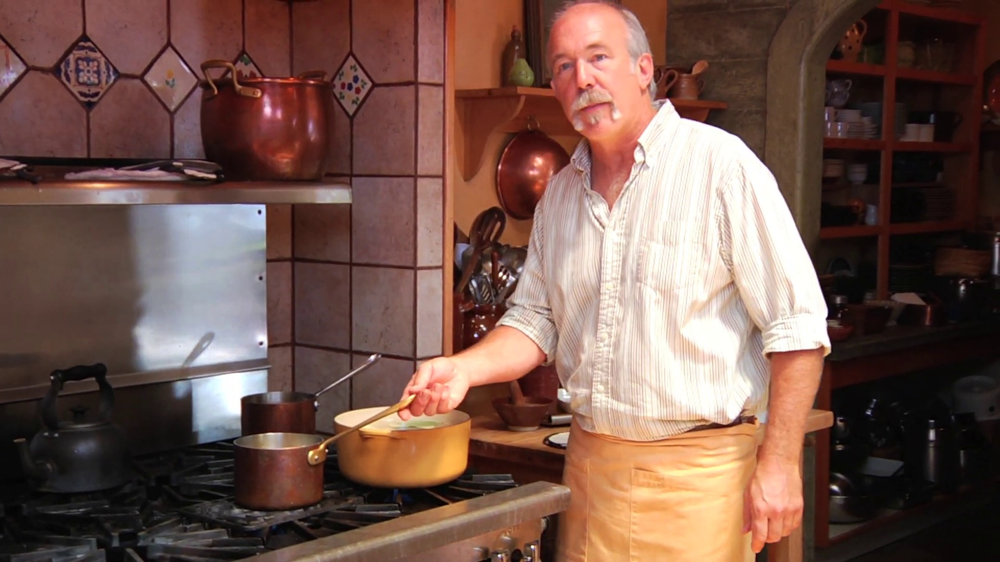

- data/frames/v_-rKS00dzFxQ/frame_0029.jpg


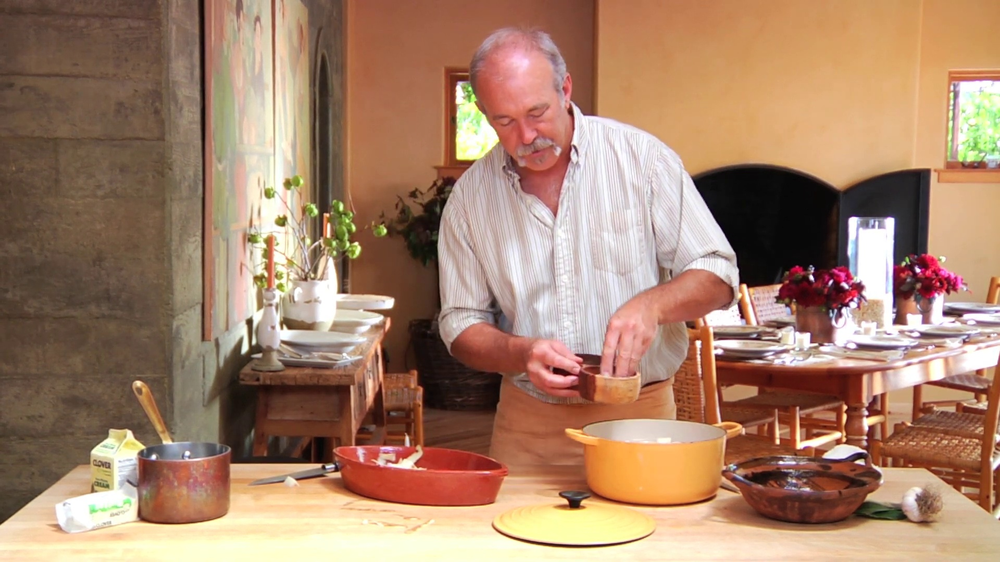

Step 2/3
🔎 Query: data/frames/v_-rKS00dzFxQ/frame_0056.jpg


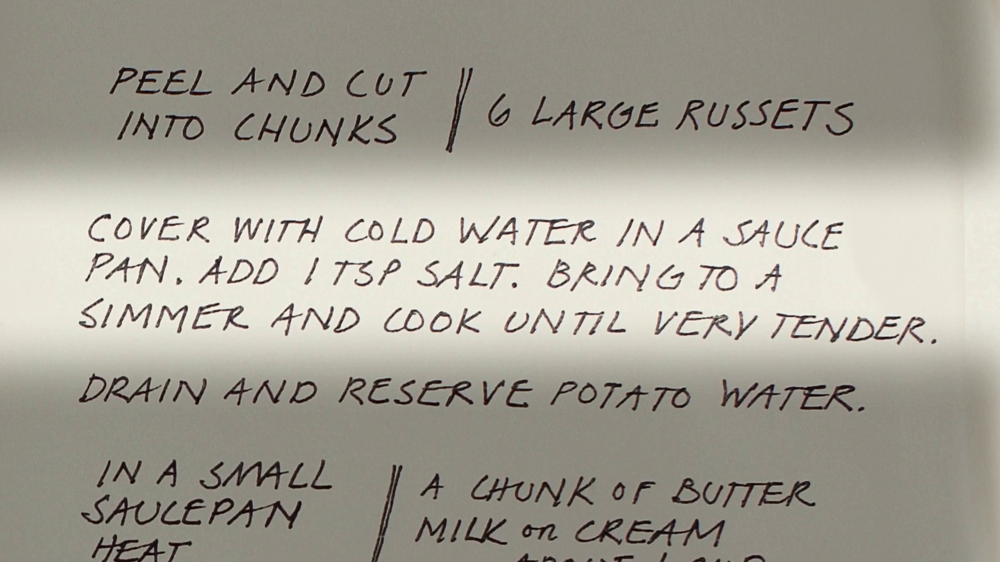

Similar Frames:
- data/frames/v_-rKS00dzFxQ/frame_0056.jpg


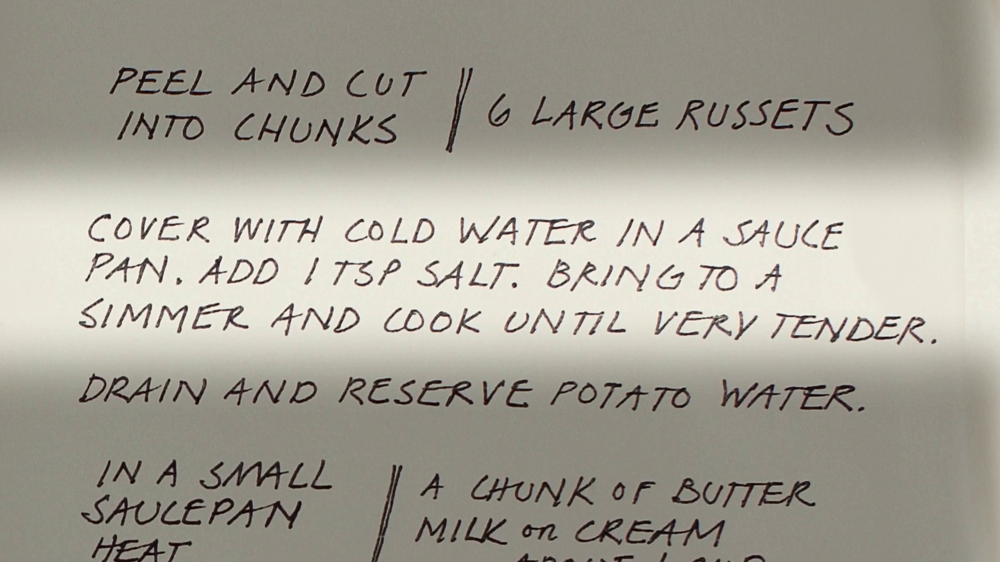

- data/frames/v_-rKS00dzFxQ/frame_0055.jpg


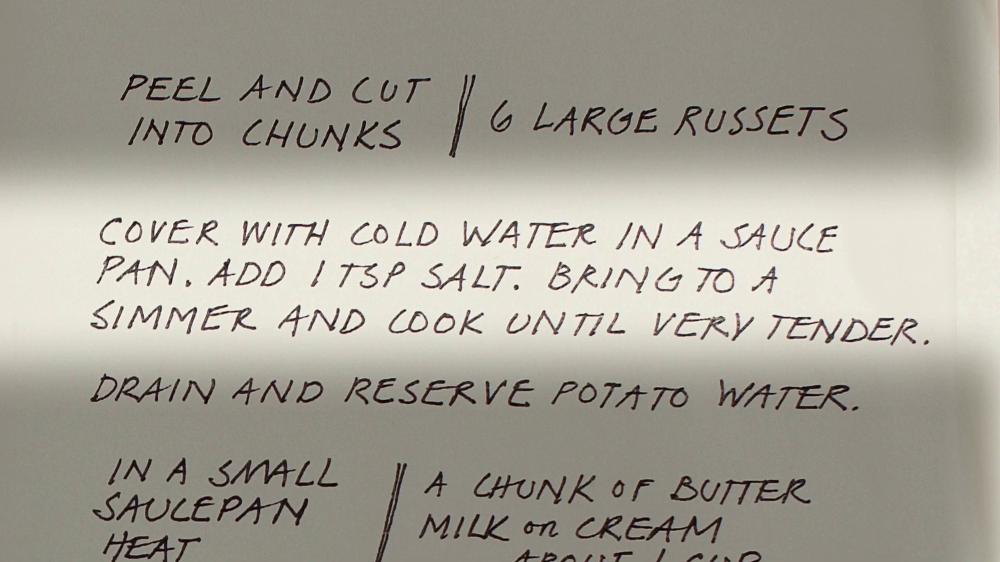

- data/frames/v_-rKS00dzFxQ/frame_0057.jpg


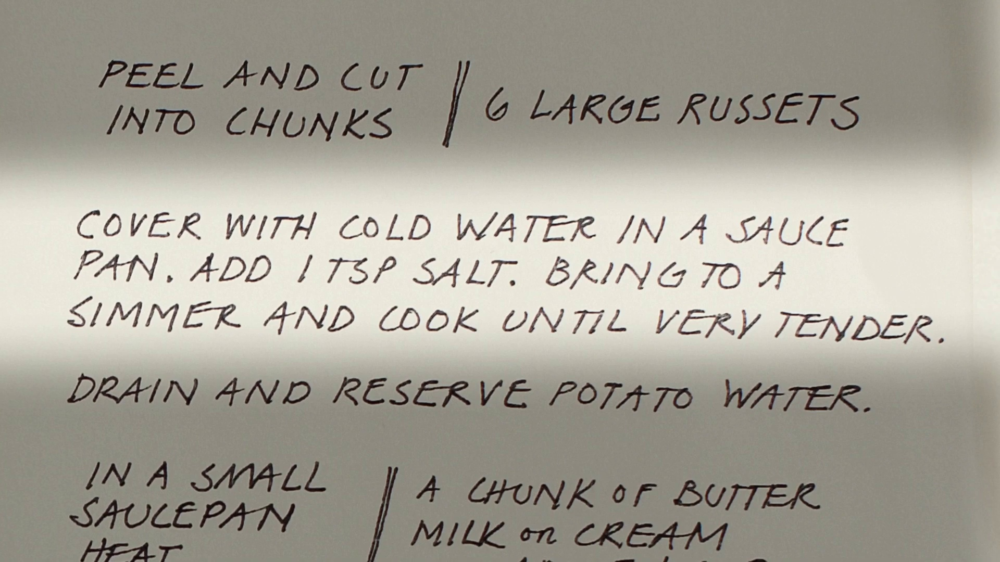

- data/frames/v_-rKS00dzFxQ/frame_0054.jpg


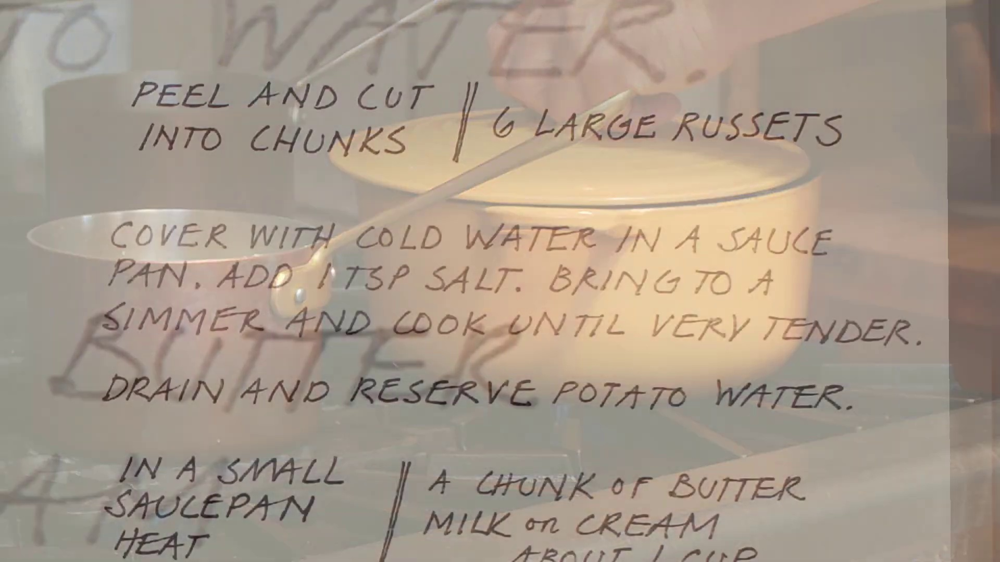

- data/frames/v_-rKS00dzFxQ/frame_0020.jpg


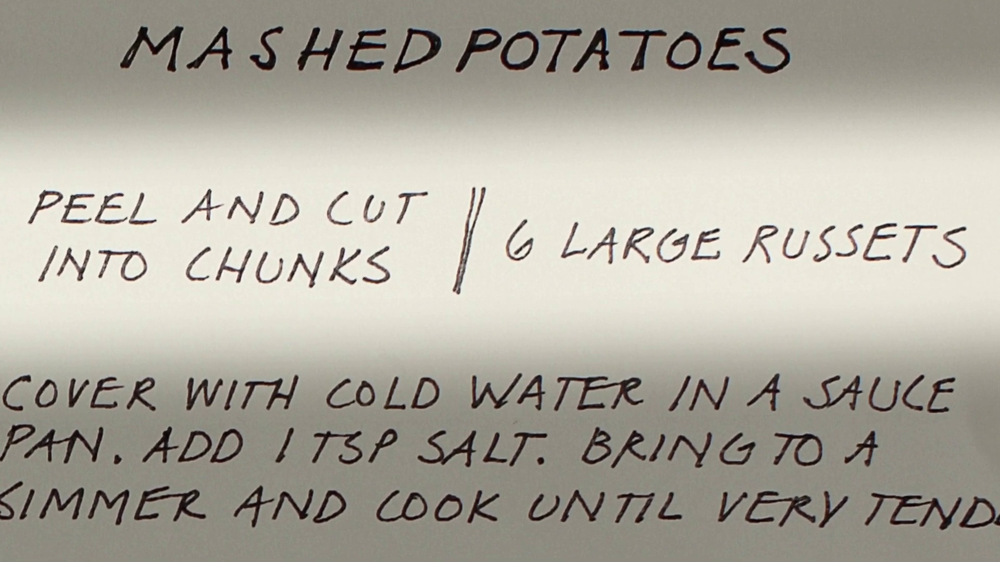

Closed.


In [8]:
start_frame = "data/frames/v_-rKS00dzFxQ/frame_0050.jpg"
navigation_by_similarity(start_frame, depth=3, k=5)